<a href="https://colab.research.google.com/github/gmauricio-toledo/NLP-LCC/blob/main/Notebooks/06-BoW-TfIdf.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h1>Semántica Vectorial</h1>

En esta notebook usaremos dos módelos de semántica vectorial para diversas tareas de NLP. Los modelos que usaremos son:

* Bag of Words (BoW). [`CountVectorizer`](https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.CountVectorizer.html)
* Term Frequency - Inverse Document Frequency (TF-IDF). [`TfidfVectorizer`](https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfVectorizer.html)

Usando estos dos modelos realicermos tareas como:

* Vecinos más cercanos
* Information Retrieval
* Segmentación
* Clasificación


In [1]:
from sklearn.feature_extraction.text import CountVectorizer
import nltk
import numpy as np
import re
import matplotlib.pyplot as plt
from nltk import word_tokenize
from nltk.corpus import stopwords
nltk.download('stopwords')
nltk.download('punkt_tab')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


True

# Corpus 1: NLTK Reuters

In [ ]:
from nltk.corpus import reuters

nltk.download('reuters')

[nltk_data] Downloading package reuters to /root/nltk_data...


True

In [ ]:
file_ids = reuters.fileids()
len(file_ids)

10788

In [ ]:
import re

docs_raw = [reuters.raw(id) for id in file_ids]
docs = [re.sub(r'\d+', ' ', doc) for doc in docs_raw]

## Modelo BOW

In [ ]:
cv = CountVectorizer(stop_words='english', max_features=1000)
X_bow = cv.fit_transform(docs)
X_bow.shape

(10788, 1000)

In [ ]:
vocabulary = cv.get_feature_names_out()

In [ ]:
frecuencias = np.sum(X_bow.toarray(), axis=0)
frecuencias.shape

(1000,)

Veamos las frecuencias de ocurrencias:

In [ ]:
frecuencias_dict = dict(sorted(zip(vocabulary, frecuencias),
                               key=lambda x: x[1], reverse=True))
frecuencias_dict

{'said': 25383,
 'mln': 18623,
 'vs': 14341,
 'dlrs': 12417,
 'pct': 9810,
 'lt': 8696,
 'cts': 8361,
 'year': 7529,
 'net': 6989,
 'billion': 5829,
 'loss': 5124,
 'company': 4670,
 'shr': 4182,
 'bank': 3654,
 'corp': 3399,
 'oil': 3272,
 'share': 3160,
 'trade': 3098,
 'profit': 2960,
 'market': 2811,
 'new': 2716,
 'qtr': 2674,
 'shares': 2652,
 'stock': 2629,
 'tonnes': 2511,
 'revs': 2312,
 'sales': 2217,
 'prices': 2195,
 'group': 2112,
 'march': 2052,
 'april': 2051,
 'japan': 1890,
 'rate': 1875,
 'quarter': 1852,
 'price': 1827,
 'february': 1817,
 'january': 1732,
 'government': 1730,
 'offer': 1720,
 'week': 1685,
 'dollar': 1646,
 'exchange': 1606,
 'note': 1584,
 'agreement': 1550,
 'tax': 1493,
 'production': 1468,
 'today': 1445,
 'foreign': 1436,
 'told': 1427,
 'international': 1420,
 'expected': 1380,
 'rose': 1366,
 'dlr': 1335,
 'rates': 1322,
 'rise': 1322,
 'total': 1321,
 'current': 1313,
 'record': 1300,
 'month': 1281,
 'end': 1244,
 'stg': 1224,
 'exports': 1

## Vectores de palabras

Exploremos los vectores de palabras, obtendremos similitudes entre ellos para averiguar las palabras más similares a otras.

In [ ]:
def get_word_vector(word):
    idx = np.where(vocabulary==word)[0][0]
    return X_bow[:, idx].toarray().flatten()

v = get_word_vector('increase')
w = get_word_vector('growth')
z = get_word_vector('world')
u = get_word_vector('wheat')

print(v.shape)
print(v)

(10788,)
[0 0 0 ... 0 0 0]


In [ ]:
from sklearn.neighbors import NearestNeighbors

nn = NearestNeighbors(n_neighbors=5, metric='cosine')
nn.fit(np.transpose(X_bow.toarray()))

NearestNeighbors(metric='cosine')

Probar varias palabras: *increase*, *wheat*, *rice*, *japan*, *march*

⭕ Prueba con diferentes palabras

In [ ]:
word = 'march'
v = get_word_vector(word)
nns = nn.kneighbors([v])
print(f"Vecinos más cercanos: {[vocabulary[idx] for idx in nns[1][0]]}")

Vecinos más cercanos: ['march', 'said', 'april', 'pct', 'february']


Obtengamos todos los vectores de palabras.

In [ ]:
word_vectors = [get_word_vector(word) for word in vocabulary]
word_vectors = np.array(word_vectors)
word_vectors.shape

(1000, 10788)

Realicemos reducción de dimensionalidad, recordemos que estamos usando la métrica coseno.

In [ ]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

tsne = TSNE(n_components=2, metric='cosine')
X_tsne_2d = tsne.fit_transform(word_vectors)

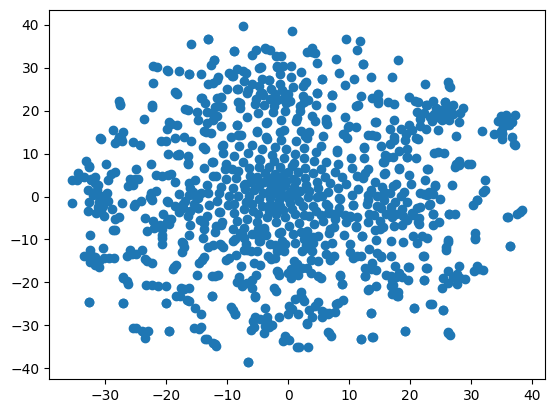

In [ ]:
plt.figure()
plt.scatter(X_tsne_2d[:,0], X_tsne_2d[:,1])
plt.show()

In [ ]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

tsne = TSNE(n_components=3,metric='cosine')
X_tsne_3d = tsne.fit_transform(word_vectors)

In [ ]:
#@title Graficamos el t-SNE 3D

import plotly
import plotly.graph_objs as go

plotly.offline.init_notebook_mode()

trace = go.Scatter3d(
    x=X_tsne_3d[:,0],
    y=X_tsne_3d[:,1],
    z=X_tsne_3d[:,2],
    mode='markers',
    marker={
        'size': 3,
        'opacity': 0.8,
        'color': 'black'
    },
    hovertemplate='%{text}<extra></extra>',
    text = [f"{vocabulary[j]}" for j in range(X_tsne_3d.shape[0])]
)

layout = go.Layout(
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
)

data = [trace]

plot_figure = go.Figure(data=data, layout=layout)

plot_figure.update_layout(
    scene = dict(
        xaxis = dict(visible=False),
        yaxis = dict(visible=False),
        zaxis =dict(visible=False)
        )
    )

plotly.offline.plot(plot_figure, filename='reuters-bow-tsne3d-words.html')

'reuters-bow-tsne3d-words.html'

## Vectores de documentos

Ahora inspeccionemos los documentos:

In [ ]:
from sklearn.neighbors import NearestNeighbors

nn = NearestNeighbors(n_neighbors=5, metric='cosine')
nn.fit(X_bow.toarray())

NearestNeighbors(metric='cosine')

Escojamos un documento aleatorio:

In [ ]:
doc_number = 157
# doc_number = np.random.randint(0, len(docs_raw))

print(docs_raw[doc_number])

JAPAN BUYS 4,000 TONNES CANADIAN RAPESEED
  Japan bought 4,000 tonnes of Canadian
  rapeseed overnight at an undisclosed price for last half
  May/first half June shipment, trade sources said.
  




Obtengamos los documentos más similares

In [ ]:
v_doc = X_bow.toarray()[doc_number,:].reshape(-1,)
nns = nn.kneighbors([v_doc])
print(f"Vecinos más cercanos: {[idx for idx in nns[1][0]]}")

for idx in nns[1][0]:
    print(f"{docs_raw[idx]}\n")

Vecinos más cercanos: [157, 490, 3997, 1928, 3687]
JAPAN BUYS 4,000 TONNES CANADIAN RAPESEED
  Japan bought 4,000 tonnes of Canadian
  rapeseed overnight at an undisclosed price for last half
  May/first half June shipment, trade sources said.
  



JAPAN BUYS 5,000 TONNES CANADIAN RAPESEED
  Japan bought 5,000 tonnes Canadian
  rapeseed overnight at an undisclosed price for May shipment,
  trade sources said.
  



JAPAN BUYS 5,000 TONNES CANADIAN RAPESEED
  Japan bought 5,000 tonnes of Canadian
  rapeseed overnight at an undisclosed price for April shipment,
  trade sources said.
  



JAPAN BUYS 8,000 TONNES OF CANADIAN RAPESEED
  Japanese crushers bought 8,000 tonnes
  of Canadian rapeseed for shipment from the last-half of July to
  September, trade sources said.
      Price details were not available.
  



JAPAN BUYS CANADIAN RAPESEED
  Japanese crushers bought 2,000 tonnes
  of Canadian rapeseed in export business overnight for May
  shipment, trade sources said.
  





Hagamos reducción de dimensionalidad con t-SNE y la métrica coseno. Veamos qué documentos están cerca de quienes.

In [ ]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

tsne = TSNE(n_components=3, metric='cosine')
X_tsne = tsne.fit_transform(X_bow.toarray())

In [ ]:
#@title Graficamos el t-SNE 3D

import plotly
import plotly.graph_objs as go

plotly.offline.init_notebook_mode()

trace = go.Scatter3d(
    x=X_tsne[:,0],
    y=X_tsne[:,1],
    z=X_tsne[:,2],
    mode='markers',
    marker={
        'size': 3,
        'opacity': 0.8,
    },
    hovertemplate='%{text}<extra></extra>',
    text = [f"{file_ids[j]}\n{reuters.raw(file_ids[j])[:50]}" for j in range(X_tsne.shape[0])]
)

layout = go.Layout(
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
)

data = [trace]

plot_figure = go.Figure(data=data, layout=layout)

plot_figure.update_layout(
    scene = dict(
        xaxis = dict(visible=False),
        yaxis = dict(visible=False),
        zaxis =dict(visible=False)
        )
    )

plotly.offline.plot(plot_figure, filename='reuters-bow-tsne3d-docs.html')

'reuters-bow-tsne3d-docs.html'

In [ ]:
print(reuters.raw('training/958')[:50])

 3-MAR-1987 07:35:58.11
   3-MAR-1987 07:35:58.11



# Corpus 2: Wikipedia

In [2]:
from nltk import word_tokenize

nltk.download('punkt_tab')
nltk.download('stopwords')

[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

Ahora probemos con otro corpus. Es una parte de un dump de wikipedia del 2006 ([información](https://www.cs.upc.edu/~nlp/wikicorpus/)).

In [3]:
import pandas as pd
import numpy as np

url = "https://raw.githubusercontent.com/gmauricio-toledo/NLP-MCD/main/data/spanish-wikipedia-dataframe.csv"
df = pd.read_csv(url,index_col=0)
df

,doc_id,Texto
0,646956,amaury iii señor montfort amaury conde évreux ...
1,646957,ruud janssen tilburg july artista holandés flu...
2,646958,grandes crónicas francia compilación obras his...
3,646961,san miguel basauri grupo barrios tomado barrio...
4,646963,río perené corto río perú constituye parte sup...
...,...,...
4018,665821,iese puede hacer referencia siguiente institut...
4019,665823,cygni abreviado cyg sistema estelar triple loc...
4020,665831,acrónimo ima puede referirse instituto mundo á...
4021,665833,eleonora cassano buenos aires enero bailarina ...


Preprocesamos y limpiamos el texto.

⭕ ¿Qué estamos haciendo al texto?

In [4]:
docs_raw = df['Texto'].tolist()
docs = [re.sub(r'\d+', ' ', doc) for doc in docs_raw]
tokenized_docs = [word_tokenize(doc) for doc in docs]
docs = [[token for token in doc if token not in nltk.corpus.stopwords.words('spanish')] for doc in tokenized_docs]
docs = [' '.join(doc) for doc in docs]
docs[:3]

['amaury iii señor montfort amaury conde évreux hijo simón señor montfort agnes évreux heredero titular guillermo conde évreux combatió bajo órdenes guillermo rojo rey inglaterra custodio normandía asaltó castillo hermano vasallo rey francia amaury sucedió hermano vasallo felipe rey francia juró fidelidad felipe repudió primera esposa berta holanda casarse bertrade hermana amaury casó primeras nupcias richilde henao hija balduino conde henao ida lovaina separarse después razones consanguinidad volvió casarse agnés garlande hija anseau garlande señor rochefortenyvelines beatrice rochefort unión nacieron inés murió casada galéran meulan conde meulan simón iii muerto conde évreux señor montfort amaury muerto señor montfort',
 'ruud janssen tilburg july artista holandés fluxus arte correo originario breda países bajos ruud janssen estudió física matemáticas actividad artista correo comenzó realizó varios proyectos internacionales mantenido contactos fluxus arte correo diversos medios comun

## Modelo BOW

Observa cómo especificamos la lista de stopwords en español.

In [5]:
stop_words = nltk.corpus.stopwords.words('spanish')

cv = CountVectorizer(stop_words=stop_words, max_features=1000)
X_bow = cv.fit_transform(docs)
X_bow.shape

(4023, 1000)

In [11]:
X_bow[:3,:7].todense()

matrix([[0, 0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0, 0]])

In [14]:
X_bow[140:143,750:756].todense()

matrix([[0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0]])

¿Qué tan *sparse* es la matriz?

In [6]:
num_ceros = np.where(X_bow.toarray()==0)[0].shape[0]
total_entradas = (X_bow.toarray().shape[0]*X_bow.toarray().shape[1])

print(f"Número de entradas: {total_entradas}")
print(f"Proporción de entradas cero: {round(100*num_ceros/total_entradas,2)} %")

Número de entradas: 4023000
Proporción de entradas cero: 94.78 %


In [7]:
vocabulary = cv.get_feature_names_out()

## Vectores de documentos

Representaciones de documentos

In [15]:
doc_vectors = X_bow.toarray()

Inspeccionemos los vecinos más cercanos de ciertos documentos

In [16]:
from sklearn.neighbors import NearestNeighbors

nn = NearestNeighbors(n_neighbors=5, metric='cosine')
nn.fit(doc_vectors)

NearestNeighbors(metric='cosine')

In [18]:
doc_number = 189
# doc_number = np.random.randint(0, len(docs_raw))

print(f"Consulta:\n\t{docs_raw[doc_number]}\n")

v_doc = doc_vectors[doc_number,:].reshape(-1,)
nns = nn.kneighbors([v_doc])
print(f"Vecinos más cercanos: {[idx for idx in nns[1][0]]}\n")

for idx,dist in zip(nns[1][0],nns[0][0]):
    print(f"Distancia: {round(dist,3)}")
    print(f"{docs_raw[idx]}\n")

Consulta:
	air guinee aerolínea operativa guinea sede capital conakry código código gib nombre air guinee historia air guinee fundada diciembre siendo reestructurada flota antonov antonov boeing bombardier dash véase conakry

Vecinos más cercanos: [189, 2770, 1716, 3021, 966]

Distancia: 0.0
air guinee aerolínea operativa guinea sede capital conakry código código gib nombre air guinee historia air guinee fundada diciembre siendo reestructurada flota antonov antonov boeing bombardier dash véase conakry

Distancia: 0.63
malaysia airlines código iata código oaci mas principal aerolínea malasia inició operaciones mayo nombre malayan airways limited mal compañía cambió nombre malaysia airline system berhad mas recibir nombre actual cuatro únicas aerolíneas obtenido calificación cinco estrellas skytrax junto qatar airways singapore airlines cathay pacific pérdidas económicas lapso prolongado marzo compañía lanzó drástico plan reestructuración abandonó rutas interiores redujo flota aeronaves 

### Information Retrieval

Inspeccionemos los vecinos más cercanos de una query

In [19]:
query = "sello discográfico de artistas de pop"

query_vector = cv.transform([query]).toarray().reshape(-1,)
print(query_vector)

responses = nn.kneighbors([query_vector])
for idx,dist in zip(responses[1][0],responses[0][0]):
    print(f"Distancia: {round(dist,3)}")
    print(f"{docs_raw[idx]}\n")

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 

In [ ]:
#@title Grafiquemos la reducción de dimensionalidad 3d t-SNE

from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import plotly
import plotly.graph_objs as go

tsne = TSNE(n_components=3, metric='cosine')
X_tsne = tsne.fit_transform(doc_vectors)

plotly.offline.init_notebook_mode()

trace = go.Scatter3d(
    x=X_tsne[:,0],
    y=X_tsne[:,1],
    z=X_tsne[:,2],
    mode='markers',
    marker={
        'size': 3,
        'opacity': 0.75,
        'color': 'black'
    },
    hovertemplate='%{text}<extra></extra>',
    text = [f"{docs_raw[j][:75]}" for j in range(X_tsne.shape[0])]
)

layout = go.Layout(
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
)

data = [trace]

plot_figure = go.Figure(data=data, layout=layout)

plot_figure.update_layout(
    title = 'Wikipedia Docs',
    scene = dict(
        xaxis = dict(visible=False),
        yaxis = dict(visible=False),
        zaxis =dict(visible=False)
        )
    )

plotly.offline.plot(plot_figure, filename='wiki-bow-tsne3d-docs.html')

'wiki-bow-tsne3d-docs.html'

### Clustering: Topic Modelling

Clustericemos los documentos. Usemos un método basado en densidad, en lugar de uno de partición.

In [20]:
from sklearn.cluster import DBSCAN

dbscan = DBSCAN(eps=0.1, min_samples=3, metric='cosine')
dbscan.fit(doc_vectors)
num_doc_clusters = np.max(dbscan.labels_)+1
print(f"Hay {num_doc_clusters} clusters")

Hay 9 clusters


In [21]:
!pip install -qq wordcloud

In [22]:
#@title función para factorizar
import math

def factor_int(n):
    val = math.ceil(math.sqrt(n))
    val2 = int(n/val)
    while val2 * val != float(n):
        val -= 1
        val2 = int(n/val)
    return val, val2

Exploremos los términos más frecuentes en cada cluster.

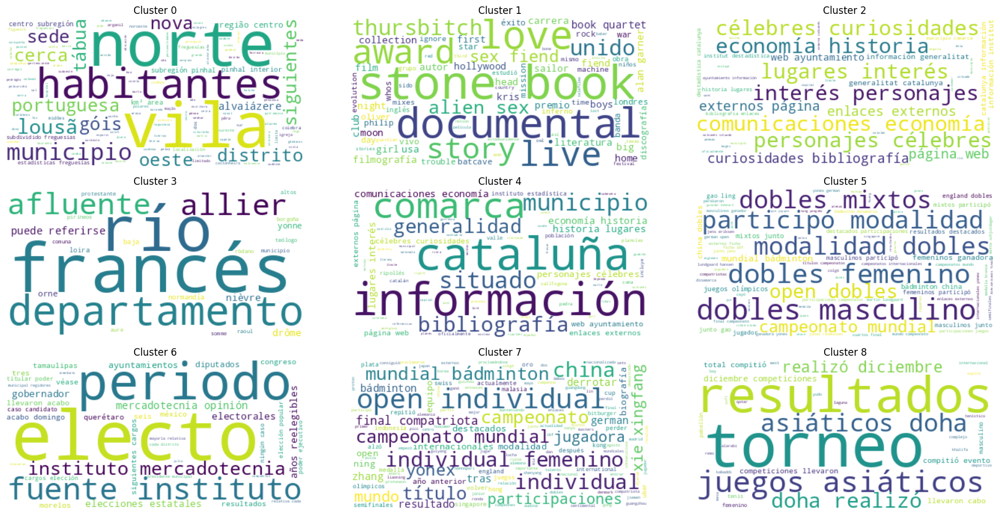

In [23]:
from wordcloud import WordCloud

idxs_per_cluster = {j: np.where(dbscan.labels_==j)[0] for j in range(num_doc_clusters)}
docs_per_cluster = {j: [docs[idx] for idx in idxs_per_cluster[j]] for j in idxs_per_cluster.keys()}

wc = WordCloud(background_color="white", max_words=1000)

w, h = factor_int(num_doc_clusters)
fig, axs = plt.subplots(w, h, figsize=(6*w, 3*h))

for j,ax in zip(idxs_per_cluster.keys(),axs.flatten()):
    wc.generate(' '.join(docs_per_cluster[j]))
    ax.imshow(wc, interpolation='bilinear')
    ax.axis("off")
    ax.set_title(f"Cluster {j}")
fig.tight_layout()
fig.show()

## Vectores de palabras

Ahora veamos las palabras:

In [24]:
def get_word_vector(word):
    idx = np.where(vocabulary==word)[0][0]
    return X_bow[:, idx].toarray().flatten()

In [25]:
word_vectors = [get_word_vector(word) for word in vocabulary]
word_vectors = np.array(word_vectors)
word_vectors.shape

(1000, 4023)

In [26]:
from sklearn.neighbors import NearestNeighbors

nn = NearestNeighbors(n_neighbors=5, metric='cosine')
nn.fit(word_vectors)

NearestNeighbors(metric='cosine')

Probemos los vecinos más cercanos de las palabras: cine, equipo, guerra, música, mayores

In [27]:
word = 'guerra'
v = get_word_vector(word)
nns = nn.kneighbors([v])
print(f"Vecinos más cercanos: {[vocabulary[idx] for idx in nns[1][0]]}")
print(f"Distancias: {[round(sim,3) for sim in nns[0][0]]}")

Vecinos más cercanos: ['guerra', 'ejército', 'militar', 'soldados', 'flota']
Distancias: [0.0, 0.478, 0.495, 0.525, 0.552]


In [ ]:
#@title Grafiquemos la reducción de dimensionalidad 3d t-SNE

tsne = TSNE(n_components=3, metric='cosine')
X_tsne = tsne.fit_transform(word_vectors)

plotly.offline.init_notebook_mode()

trace = go.Scatter3d(
    x=X_tsne[:,0],
    y=X_tsne[:,1],
    z=X_tsne[:,2],
    mode='markers',
    marker={
        'size': 3,
        'opacity': 0.75,
        'color': 'black'
    },
    hovertemplate='%{text}<extra></extra>',
    text = [f"{vocabulary[j]}" for j in range(X_tsne.shape[0])]
)

layout = go.Layout(
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
)

data = [trace]

plot_figure = go.Figure(data=data, layout=layout)

plot_figure.update_layout(
    title = 'Wikipedia Words',
    scene = dict(
        xaxis = dict(visible=False),
        yaxis = dict(visible=False),
        zaxis =dict(visible=False)
        )
    )

plotly.offline.plot(plot_figure, filename='wiki-bow-tsne3d-words.html')

'wiki-bow-tsne3d-words.html'

In [ ]:
pip install -qq umap-learn

import umap

### Clustering

Analicemos algunos clusters de palabras

In [ ]:
from sklearn.cluster import KMeans

n_clusters = 5

kmeans = KMeans(n_clusters=n_clusters, random_state=0, n_init='auto')
kmeans.fit(word_vectors)

In [ ]:
for j in range(n_clusters):
    print(f"Cluster {j}:")
    print([vocabulary[idx] for idx in np.where(kmeans.labels_==j)[0]])

Cluster 0:
['aang', 'abril', 'academia', 'acceso', 'acciones', 'acción', 'acerca', 'actividad', 'actividades', 'actor', 'actriz', 'actual', 'actualidad', 'actualmente', 'acuerdo', 'además', 'administración', 'aeropuerto', 'agosto', 'agua', 'aguas', 'ahora', 'aire', 'aires', 'alcalde', 'alemania', 'alemán', 'alfonso', 'alguna', 'algún', 'alianza', 'allí', 'alrededor', 'alta', 'alto', 'altura', 'ambas', 'ambos', 'amigo', 'amigos', 'amor', 'américa', 'ana', 'angel', 'animales', 'anna', 'anterior', 'antigua', 'antiguo', 'antiguos', 'antonio', 'análisis', 'aparece', 'apoyo', 'aproximadamente', 'aquel', 'aquellos', 'aquí', 'argentina', 'argentino', 'armas', 'arquitectura', 'arte', 'artes', 'artistas', 'artículo', 'artículos', 'así', 'ataque', 'atenas', 'aunque', 'australia', 'autor', 'autores', 'ayuda', 'ayuntamiento', 'azul', 'año', 'años', 'aún', 'baja', 'bajo', 'banda', 'barcelona', 'barrio', 'base', 'bastante', 'batalla', 'batería', 'bibliografía', 'biblioteca', 'bien', 'biografía', 'bla

Analicemos los casos de *familia*, *campeón*

In [ ]:
word = 'campeón'
v = get_word_vector(word)
nns = nn.kneighbors([v])
print(f"Vecinos más cercanos: {[vocabulary[idx] for idx in nns[1][0]]}")
print(f"Distancias: {[round(sim,3) for sim in nns[0][0]]}")

Vecinos más cercanos: ['campeón', 'mundial', 'tko', 'ptos', 'vegas']
Distancias: [0.0, 0.006, 0.007, 0.007, 0.008]


⭕ ¿Por qué tenemos estos resultados que no corresponden a la gráfica?

In [ ]:
from sklearn.cluster import AgglomerativeClustering

agglom = AgglomerativeClustering(n_clusters=n_clusters, metric='cosine',linkage='average')
agglom.fit(word_vectors)

AgglomerativeClustering(linkage='average', metric='cosine', n_clusters=5)

In [ ]:
for j in range(n_clusters):
    print(f"Cluster {j}:")
    print([vocabulary[idx] for idx in np.where(agglom.labels_==j)[0]])

Cluster 0:
['aang', 'abril', 'academia', 'acceso', 'acciones', 'acción', 'acerca', 'actividad', 'actividades', 'actor', 'actriz', 'actual', 'actualidad', 'actualmente', 'acuerdo', 'además', 'administración', 'aeropuerto', 'agosto', 'agua', 'aguas', 'ahora', 'aire', 'aires', 'alcalde', 'alemania', 'alemán', 'alfonso', 'alguna', 'algún', 'allí', 'alrededor', 'alta', 'alto', 'altura', 'ambas', 'ambos', 'amigo', 'amigos', 'amor', 'américa', 'ana', 'and', 'angel', 'animales', 'anna', 'anterior', 'antigua', 'antiguo', 'antiguos', 'antonio', 'análisis', 'aparece', 'apoyo', 'aproximadamente', 'aquel', 'aquellos', 'aquí', 'argentina', 'argentino', 'armas', 'arquitectura', 'arte', 'artes', 'artistas', 'artículo', 'artículos', 'asociación', 'así', 'ataque', 'atenas', 'aunque', 'australia', 'autor', 'autores', 'ayuda', 'ayuntamiento', 'azul', 'año', 'años', 'aún', 'baja', 'bajo', 'banda', 'barcelona', 'barrio', 'base', 'bastante', 'batalla', 'batería', 'bibliografía', 'biblioteca', 'bien', 'biogra

In [ ]:
word = 'abril'
v = get_word_vector(word)
nns = nn.kneighbors([v])
print(f"Vecinos más cercanos: {[vocabulary[idx] for idx in nns[1][0]]}")
print(f"Distancias: {[round(sim,3) for sim in nns[0][0]]}")

Vecinos más cercanos: ['abril', 'noviembre', 'marzo', 'octubre', 'julio']
Distancias: [0.0, 0.612, 0.613, 0.635, 0.635]


In [ ]:
from sklearn.cluster import DBSCAN

dbscan = DBSCAN(eps=0.35, min_samples=2, metric='cosine')
dbscan.fit(word_vectors)

DBSCAN(eps=0.35, metric='cosine', min_samples=2)

In [ ]:
for j in np.unique(dbscan.labels_):
    print(f"Cluster {j}:")
    print([vocabulary[idx] for idx in np.where(dbscan.labels_==j)[0]])

Cluster -1:
['aang', 'abril', 'academia', 'acceso', 'acciones', 'acción', 'acerca', 'actividad', 'actividades', 'actor', 'actriz', 'actual', 'actualidad', 'actualmente', 'acuerdo', 'además', 'administración', 'aeropuerto', 'agosto', 'agua', 'aguas', 'ahora', 'aire', 'alcalde', 'alemania', 'alemán', 'alfonso', 'alguna', 'algún', 'alianza', 'allí', 'alrededor', 'alta', 'alto', 'altura', 'ambas', 'ambos', 'amigo', 'amigos', 'amor', 'américa', 'and', 'angel', 'animales', 'anna', 'anterior', 'antigua', 'antiguo', 'antiguos', 'antonio', 'análisis', 'aparece', 'apoyo', 'aproximadamente', 'aquel', 'aquellos', 'aquí', 'argentina', 'argentino', 'armas', 'arquitectura', 'arte', 'artes', 'artistas', 'artículo', 'artículos', 'así', 'ataque', 'aunque', 'australia', 'autor', 'autores', 'ayuda', 'ayuntamiento', 'azul', 'año', 'años', 'aún', 'bajo', 'banda', 'barcelona', 'barrio', 'base', 'bastante', 'batalla', 'batería', 'bibliografía', 'biblioteca', 'bien', 'biografía', 'blanca', 'blanco', 'bosque', 

## Modelo TF-IDF

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

stop_words = nltk.corpus.stopwords.words('spanish')

tfv = TfidfVectorizer(stop_words=stop_words, max_features=1000)
X_tfidf = tfv.fit_transform(docs)
print(X_tfidf.shape)

(4023, 1000)


Ver la matriz, ¿es más sparse? Tenía el 94.78% de entradas en 0

In [ ]:
tota_entradas = X_tfidf.shape[0]*X_tfidf.shape[1]
num_ceros = np.where(X_tfidf.toarray()==0)[0].shape[0]

print(f"Número de entradas: {total_entradas}")
print(f"Proporción de entradas cero: {round(100*num_ceros/total_entradas,2)} %")

Número de entradas: 4023000
Proporción de entradas cero: 94.78 %


### Vectores de palabras

In [ ]:
vocabulary = tfv.get_feature_names_out()

def get_word_vector(word):
    idx = np.where(vocabulary==word)[0][0]
    return X_tfidf[:, idx].toarray().flatten()

In [ ]:
word_vectors = [get_word_vector(word) for word in vocabulary]
word_vectors = np.array(word_vectors)
word_vectors.shape

(1000, 4023)

In [ ]:
nn = NearestNeighbors(n_neighbors=5, metric='cosine')
nn.fit(word_vectors)

word = 'años'
v = get_word_vector(word)
nns = nn.kneighbors([v])
print(f"Vecinos más cercanos: {[vocabulary[idx] for idx in nns[1][0]]}")
print(f"Distancias: {[round(sim,3) for sim in nns[0][0]]}")

Vecinos más cercanos: ['años', 'edad', 'después', 'tarde', 'vida']
Distancias: [0.0, 0.676, 0.683, 0.725, 0.735]


In [ ]:
#@title Grafiquemos la reducción de dimensionalidad 3d con t-SNE

from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import plotly
import plotly.graph_objs as go

tsne = TSNE(n_components=3,metric='cosine')
X_tsne = tsne.fit_transform(word_vectors)

plotly.offline.init_notebook_mode()

trace = go.Scatter3d(
    x=X_tsne[:,0],
    y=X_tsne[:,1],
    z=X_tsne[:,2],
    mode='markers',
    marker={
        'size': 3,
        'opacity': 0.75,
        'color': 'black'
    },
    hovertemplate='%{text}<extra></extra>',
    text = [f"{vocabulary[j]}" for j in range(X_tsne.shape[0])]
)

layout = go.Layout(
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
)

data = [trace]

plot_figure = go.Figure(data=data, layout=layout)

plot_figure.update_layout(
    title = 'Wikipedia Words',
    scene = dict(
        xaxis = dict(visible=False),
        yaxis = dict(visible=False),
        zaxis =dict(visible=False)
        )
    )

plotly.offline.plot(plot_figure, filename='wiki-tfidf-tsne3d-words.html')

'wiki-tfidf-tsne3d-words.html'

### Vectores de documentos

In [ ]:
doc_vectors = X_tfidf.toarray()

In [ ]:
from sklearn.neighbors import NearestNeighbors

nn = NearestNeighbors(n_neighbors=5, metric='cosine')
nn.fit(doc_vectors)

NearestNeighbors(metric='cosine')

### Information Retrieval

In [ ]:
# query = "sello discográfico de artistas de pop"
query = "acontecimientos importantes en abril o nacido en abril"

query_vector = tfv.transform([query]).toarray().reshape(-1,)

if np.sum(query_vector)==0:
    print("Query no válida (OOV)")
else:
    responses = nn.kneighbors([query_vector])
    for idx,dist in zip(responses[1][0],responses[0][0]):
        print(f"Distancia: {round(dist,3)}")
        print(f"{docs_raw[idx]}\n")

Distancia: 0.465
tripulación tripulantes lanzados aterrizados iss expedición gennady padalka edward fincke lanzados andré kuipers aterrizados yuri shargin parámetros misión masa perigeo apogeo inclinación periodo min maniobras iss arribo iss abril utc puerto nadir zarya partida iss octubre utc puerto nadir zarya registro misiones vuelo tripulado iss soyuz tma nave espacial soyuz lanzada abril utc vehículo soyuz lanzamiento cosmodromo baikonur gennady padalka rusia michael fincke unidos andré kuipers países bajos volaron iss kuipers retornó tierra días tarde junto tripulación iss módulo reentrada soyuz tma dos permanecieron tripulación iss soyuz tma permanecerá siguiente cambio tripulación soyuz tma nave espacial tripulada rusa lanzada cohete soyuzfg baikonur abril llevaba tres astronautas ruso norteamericano holandés estación espacial internacional iss acoplado módulo zarya iss automáticamente abril dos astronautas permanecieron iss seis meses mientras tripulante holandés dos restantes

In [ ]:
#@title Reducción de dimensionalidad 3d t-SNE

from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import plotly
import plotly.graph_objs as go

tsne = TSNE(n_components=3, metric='cosine')
X_tsne = tsne.fit_transform(doc_vectors)

plotly.offline.init_notebook_mode()

trace = go.Scatter3d(
    x=X_tsne[:,0],
    y=X_tsne[:,1],
    z=X_tsne[:,2],
    mode='markers',
    marker={
        'size': 3,
        'opacity': 0.75,
        'color': 'black'
    },
    hovertemplate='%{text}<extra></extra>',
    text = [f"{docs_raw[j][:75]}" for j in range(X_tsne.shape[0])]
)

layout = go.Layout(
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
)

data = [trace]

plot_figure = go.Figure(data=data, layout=layout)

plot_figure.update_layout(
    title = 'Wikipedia Docs',
    scene = dict(
        xaxis = dict(visible=False),
        yaxis = dict(visible=False),
        zaxis =dict(visible=False)
        )
    )

plotly.offline.plot(plot_figure, filename='wiki-tfidf-tsne3d-docs.html')

'wiki-tfidf-tsne3d-docs.html'

In [ ]:
!pip install -qq umap-learn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.7/85.7 kB 916.5 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 1.1 MB/s eta 0:00:00


In [ ]:
#@title Reducción de dimensionalidad 3d UMAP

from umap import UMAP
import matplotlib.pyplot as plt
import plotly
import plotly.graph_objs as go

umap = UMAP(n_components=3, metric='cosine')
X_umap = umap.fit_transform(doc_vectors)

plotly.offline.init_notebook_mode()

trace = go.Scatter3d(
    x=X_umap[:,0],
    y=X_umap[:,1],
    z=X_umap[:,2],
    mode='markers',
    marker={
        'size': 3,
        'opacity': 0.75,
        'color': 'black'
    },
    hovertemplate='%{text}<extra></extra>',
    text = [f"{docs_raw[j][:75]}" for j in range(X_umap.shape[0])]
)

layout = go.Layout(
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
)

data = [trace]

plot_figure = go.Figure(data=data, layout=layout)

plot_figure.update_layout(
    title = 'Wikipedia Docs',
    scene = dict(
        xaxis = dict(visible=False),
        yaxis = dict(visible=False),
        zaxis = dict(visible=False)
        )
    )

plotly.offline.plot(plot_figure, filename='wiki-tfidf-umap3d-docs.html')

'wiki-tfidf-umap3d-docs.html'

### Clustering

In [ ]:
from sklearn.cluster import DBSCAN

dbscan = DBSCAN(eps=0.1, min_samples=3, metric='cosine')
dbscan.fit(doc_vectors)
num_doc_clusters = np.max(dbscan.labels_)+1
print(f"Hay {num_doc_clusters} clusters")

idxs_per_cluster = {j: np.where(dbscan.labels_==j)[0] for j in range(num_doc_clusters)}
docs_per_cluster = {j: [docs[idx] for idx in idxs_per_cluster[j]] for j in idxs_per_cluster.keys()}

Hay 10 clusters


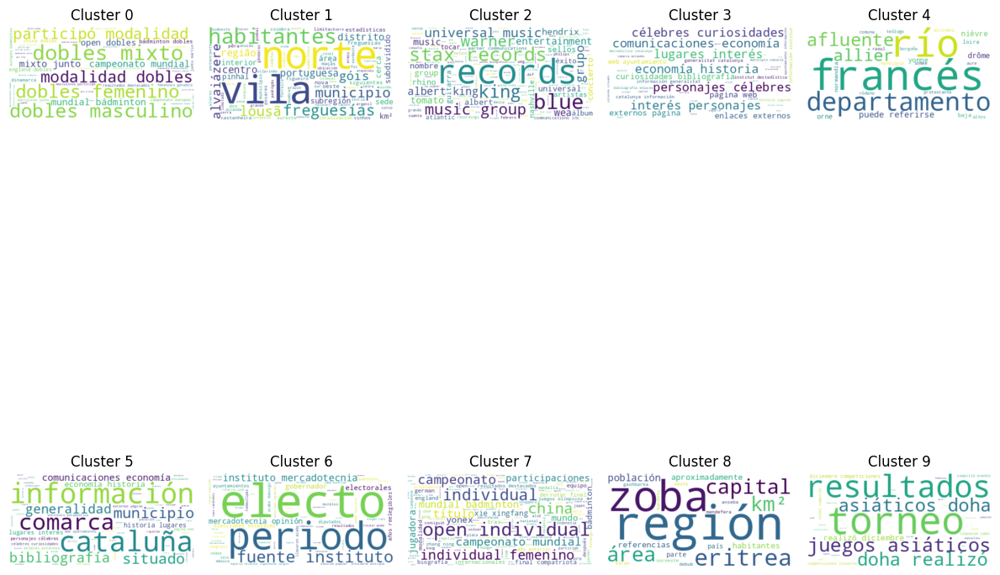

In [ ]:
from wordcloud import WordCloud

wc = WordCloud(background_color="white", max_words=1000)

w, h = factor_int(num_doc_clusters)
fig, axs = plt.subplots(w, h, figsize=(6*w, 3*h))

for j,ax in zip(idxs_per_cluster.keys(),axs.flatten()):
    wc.generate(' '.join(docs_per_cluster[j]))
    ax.imshow(wc, interpolation='bilinear')
    ax.axis("off")
    ax.set_title(f"Cluster {j}")
fig.tight_layout()
fig.show()

In [ ]:
#@title visualizar clusters en la reducción de dimensionalidad

from umap import UMAP
import matplotlib.pyplot as plt
import plotly
import plotly.graph_objs as go

umap = UMAP(n_components=3, metric='cosine')
X_umap = umap.fit_transform(doc_vectors)

plotly.offline.init_notebook_mode()

trace = go.Scatter3d(
    x=X_umap[:,0],
    y=X_umap[:,1],
    z=X_umap[:,2],
    mode='markers',
    marker={
        'size': 3,
        'opacity': 0.25,
        'color': 'gray'
    },
    hovertemplate='%{text}<extra></extra>',
    text = [f"{docs_raw[j][:75]}" for j in range(X_umap.shape[0])]
)

layout = go.Layout(
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
)

data = [trace]

plot_figure = go.Figure(data=data, layout=layout)

for j in idxs_per_cluster.keys():
    Xs = X_umap[idxs_per_cluster[j],0]
    Ys = X_umap[idxs_per_cluster[j],1]
    Zs = X_umap[idxs_per_cluster[j],2]
    plot_figure.add_trace(
        go.Scatter3d(
            x=Xs,
            y=Ys,
            z=Zs,
            mode='markers',
            marker={
                'size': 3,
                'opacity': 0.75
            },
            hovertemplate='%{text}<extra></extra>',
            text = [f"{docs_raw[j][:75]}" for j in range(X_umap.shape[0])]
        )
    )

plot_figure.update_layout(
    title = 'Wikipedia Docs',
    scene = dict(
        xaxis = dict(visible=False),
        yaxis = dict(visible=False),
        zaxis = dict(visible=False)
        )
    )

plotly.offline.plot(plot_figure, filename='wiki-tfidf-umap3d-docs-clusters.html')

'wiki-tfidf-umap3d-docs-clusters.html'

# Features como clasificación

Finalmente usamos los vectores de documentos como features para un clasificador. Hasta el momento, sólo *sabíamos* hacer la clasificación con los $n$-gramas.

In [28]:
from sklearn.datasets import fetch_20newsgroups

# train_docs = fetch_20newsgroups(subset='train', remove=('headers', 'footers', 'quotes'))
# test_docs = fetch_20newsgroups(subset='test', remove=('headers', 'footers', 'quotes'))

train_docs = fetch_20newsgroups(subset='train', remove=('headers', 'footers', 'quotes'), categories=['sci.med', 'sci.space'])
test_docs = fetch_20newsgroups(subset='test', remove=('headers', 'footers', 'quotes'), categories=['sci.med', 'sci.space'])

y_train = train_docs.target
y_test = test_docs.target

y_train.shape, y_test.shape

((1187,), (790,))

In [29]:
train_docs.data[0]

'From: "Phil G. Fraering" <pgf@srl03.cacs.usl.edu>\n\nRight, the Profiting Caste is blessed by God, and may \n freely blare its presence in the evening twilight ..\n'

# BoW

In [30]:
from sklearn.feature_extraction.text import CountVectorizer

cv = CountVectorizer(max_features=1000,stop_words='english')
X_train = cv.fit_transform(train_docs.data)
X_test = cv.transform(test_docs.data)

In [31]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score, classification_report

lr = LogisticRegression()
lr.fit(X_train, y_train)
y_pred = lr.predict(X_test)

print(classification_report(y_test, y_pred))
print(f"F1 score: {f1_score(y_test, y_pred, average='weighted')}")

              precision    recall  f1-score   support

           0       0.86      0.81      0.83       396
           1       0.82      0.86      0.84       394

    accuracy                           0.84       790
   macro avg       0.84      0.84      0.84       790
weighted avg       0.84      0.84      0.84       790

F1 score: 0.8366044049461535


In [ ]:
#@title visualizar clases en la reducción de dimensionalidad
!pip install -qq umap-learn

from umap import UMAP
import matplotlib.pyplot as plt
import plotly
import plotly.graph_objs as go

umap = UMAP(n_components=3, metric='cosine')
X_umap = umap.fit_transform(X_train)

plotly.offline.init_notebook_mode()


layout = go.Layout(
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
)

plot_figure = go.Figure(layout=layout)

for j in np.unique(y_train):
    Xs = X_umap[y_train==j,0].reshape(-1,)
    Ys = X_umap[y_train==j,1].reshape(-1,)
    Zs = X_umap[y_train==j,2].reshape(-1,)
    plot_figure.add_trace(
        go.Scatter3d(
            x=Xs,
            y=Ys,
            z=Zs,
            mode='markers',
            marker={
                'size': 3,
                'opacity': 0.75
            },
            hovertemplate='%{text}<extra></extra>',
            text = [f"{train_docs.data[j][:75]}" for j in range(Xs.shape[0])],
            name = train_docs.target_names[j]
        )
    )

plot_figure.update_layout(
    scene = dict(
        xaxis = dict(visible=False),
        yaxis = dict(visible=False),
        zaxis = dict(visible=False)
        )
    )

plotly.offline.plot(plot_figure, filename='20ng-bow-umap3d-docs-classes.html')

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.7/85.7 kB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 3.0 MB/s eta 0:00:00


'20ng-bow-umap3d-docs-classes.html'

## Tf-idf

In [32]:
from sklearn.feature_extraction.text import TfidfVectorizer

cv = TfidfVectorizer(max_features=1000,stop_words='english')
X_train = cv.fit_transform(train_docs.data)
X_test = cv.transform(test_docs.data)

In [33]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score, classification_report

lr = LogisticRegression()
lr.fit(X_train, y_train)

y_pred = lr.predict(X_test)

print(classification_report(y_test, y_pred))
print(f"F1 score: {f1_score(y_test, y_pred, average='weighted')}")

              precision    recall  f1-score   support

           0       0.90      0.85      0.87       396
           1       0.85      0.90      0.88       394

    accuracy                           0.87       790
   macro avg       0.88      0.87      0.87       790
weighted avg       0.88      0.87      0.87       790

F1 score: 0.8745864915103619


Al usar un método interpretable, como regresión logística, podemos obtener la importancia de las variables, en este caso, las palabras del vocabulario.

In [34]:
lr.coef_.shape

(1, 1000)

Veamos las palabras que más influyen en la clasificación de la clase *positiva*

In [35]:
word_importance = zip(cv.get_feature_names_out() ,lr.coef_.reshape(-1,))
word_importance = sorted(word_importance, key=lambda x: x[1], reverse=True)

word_importance[:10]

[('space', 4.600336379736478),
 ('nasa', 2.0266550342612124),
 ('orbit', 1.8696777617731508),
 ('earth', 1.7664816541156982),
 ('moon', 1.7588264174192494),
 ('launch', 1.577471376824158),
 ('spacecraft', 1.317296498049548),
 ('lunar', 1.277372620590303),
 ('shuttle', 1.2289029543701513),
 ('solar', 1.1861020679544296)]

In [ ]:
#@title visualizar clases en la reducción de dimensionalidad

from umap import UMAP
import matplotlib.pyplot as plt
import plotly
import plotly.graph_objs as go

umap = UMAP(n_components=3, metric='cosine')
X_umap = umap.fit_transform(X_train)

plotly.offline.init_notebook_mode()


layout = go.Layout(
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
)

plot_figure = go.Figure(layout=layout)

for j in np.unique(y_train):
    Xs = X_umap[y_train==j,0].reshape(-1,)
    Ys = X_umap[y_train==j,1].reshape(-1,)
    Zs = X_umap[y_train==j,2].reshape(-1,)
    plot_figure.add_trace(
        go.Scatter3d(
            x=Xs,
            y=Ys,
            z=Zs,
            mode='markers',
            marker={
                'size': 3,
                'opacity': 0.75
            },
            hovertemplate='%{text}<extra></extra>',
            text = [f"{train_docs.data[j][:75]}" for j in range(Xs.shape[0])],
            name = train_docs.target_names[j]
        )
    )

plot_figure.update_layout(
    scene = dict(
        xaxis = dict(visible=False),
        yaxis = dict(visible=False),
        zaxis = dict(visible=False)
        )
    )

plotly.offline.plot(plot_figure, filename='20ng-tfidf-umap3d-docs-classes.html')

'20ng-tfidf-umap3d-docs-classes.html'

# 🟥 Ejercicios Tarea

**Tarea de clasificación con el corpus `20newsgroups`**. Probar las siguientes estrategias y en cada caso medir el F1 score:

1. Todas las clases, sin quitar *headers*, *quotes*, *footers*. Comparar:
 * BOW
 * TF-IDF
 * BOW + PCA
 * TF-IDF + PCA
 * BOW + t-SNE
 * TF-IDF + t-SNE
2. Las mismas 6 estrategias del paso anterior, quitando *headers*, *quotes*, *footers*.
3. Escoge dos clases que crees que se diferencien muy bien entre sí con estos modelos. ¿Qué clases escogiste y por qué? Compara BOW y TF-IDF para la clasificación binaria.
4. Compara tu clasificador de la tarea pasada con el mejor clasificador del paso 3.
5. Escoge ahora dos clases que crees que no se diferencien entre sí con estos modelos. ¿Qué clases escogiste y por qué? Compara BOW y TF-IDF para la clasificación binaria. ¿Qué tanto bajó el rendimiento respecto al paso 3?
6. En tu mejor clasificador del paso 3, prueba bajando y subiendo el parámetro `max_features` ¿qué efecto tiene esto en la tarea de clasificación?
7. ¿Qué efecto tiene lematizar el texto en la tarea de clasificación? Prueba con tu mejor clasificador binario.

En cada uno de los modelos BOW/TF-IDF que construyas puedes ajustar el hiperparámetro `max_features`.

**Information Retrieval con el corpus `20newsgroups`** Entrena un modelo BOW y un TF-IDF con todos los documentos juntos de `train` y `test`. Realiza algunas consultas al modelo para obtener los documentos más relevantes para tu busqueda. Reporta algunos casos que creas interesantes y explica porque los consideras interesantes.

**Análisis de sentimientos con BOW/TFIDF**. Usando el corpus de la tarea anterior (el de turismo), entrena un clasificador de Machine Learning con los embeddings BOW/TF-IDF, ¿mejora el rendimiento respecto al que presentaste en clase?
